# Libraries

In [2]:
import pandas as pd
import geopandas as gpd
import numpy as np
from matplotlib import pyplot as pp
from plotly.offline import init_notebook_mode, iplot
import plotly.io as pio
import plotly.express as px
import plotly.graph_objects as go

# Proficiency Dataset

## Setup

In [16]:
df = pd.read_csv("./data/primary/proficiency (SA3).csv")[["Age", "Region", "Proficiency", "Sex", "Year", "Value"]]
df

,Age,Region,Proficiency,Sex,Year,Value
0,0 - 4,Adelaide City,Speaks English only,Males,2006,125
1,0 - 4,Adelaide City,Speaks English only,Males,2011,145
2,0 - 4,Adelaide City,Speaks English only,Males,2016,123
3,0 - 4,Adelaide City,Speaks English only,Females,2006,116
4,0 - 4,Adelaide City,Speaks English only,Females,2011,150
...,...,...,...,...,...,...
18895,100 and over,Special Purpose Codes SA3 (SA),Speaks other language and speaks English: Not ...,Males,2011,0
18896,100 and over,Special Purpose Codes SA3 (SA),Speaks other language and speaks English: Not ...,Males,2016,0
18897,100 and over,Special Purpose Codes SA3 (SA),Speaks other language and speaks English: Not ...,Females,2006,0
18898,100 and over,Special Purpose Codes SA3 (SA),Speaks other language and speaks English: Not ...,Females,2011,0


In [17]:
df.loc[(df.Age == "100 and over"), "Age"] = "100+"
df.loc[(df.Proficiency == "Speaks English only"), "Proficiency"] = "English Only"
df.loc[(df.Proficiency == "Speaks other language and speaks English: Very well"), "Proficiency"] = "Very Good"
df.loc[(df.Proficiency == "Speaks other language and speaks English: Well"), "Proficiency"] = "Good"
df.loc[(df.Proficiency == "Speaks other language and speaks English: Not well"), "Proficiency"] = "Not Good"
df.loc[(df.Proficiency == "Speaks other language and speaks English: Not at all"), "Proficiency"] = "None"
df.loc[(df.Sex == "Males"), "Sex"] = "Male"
df.loc[(df.Sex == "Females"), "Sex"] = "Female"
df

,Age,Region,Proficiency,Sex,Year,Value
0,0 - 4,Adelaide City,English Only,Male,2006,125
1,0 - 4,Adelaide City,English Only,Male,2011,145
2,0 - 4,Adelaide City,English Only,Male,2016,123
3,0 - 4,Adelaide City,English Only,Female,2006,116
4,0 - 4,Adelaide City,English Only,Female,2011,150
...,...,...,...,...,...,...
18895,100+,Special Purpose Codes SA3 (SA),None,Male,2011,0
18896,100+,Special Purpose Codes SA3 (SA),None,Male,2016,0
18897,100+,Special Purpose Codes SA3 (SA),None,Female,2006,0
18898,100+,Special Purpose Codes SA3 (SA),None,Female,2011,0


In [72]:
df.set_index("Age").to_csv("./data/main.csv")

## Age

In [74]:
age = pd.read_csv("./data/main.csv")
age.loc[(age.Age == "0 - 4"), "Age"] = 2.5
age.loc[(age.Age == "5 - 9"), "Age"] = 7.5
age.loc[(age.Age == "10 - 14"), "Age"] = 12.5
age.loc[(age.Age == "15 - 19"), "Age"] = 17.5
age.loc[(age.Age == "20 - 24"), "Age"] = 22.5
age.loc[(age.Age == "25 - 29"), "Age"] = 27.5
age.loc[(age.Age == "30 - 34"), "Age"] = 32.5
age.loc[(age.Age == "35 - 39"), "Age"] = 37.5
age.loc[(age.Age == "40 - 44"), "Age"] = 42.5
age.loc[(age.Age == "45 - 49"), "Age"] = 47.5
age.loc[(age.Age == "50 - 54"), "Age"] = 52.5
age.loc[(age.Age == "55 - 59"), "Age"] = 57.5
age.loc[(age.Age == "60 - 64"), "Age"] = 62.5
age.loc[(age.Age == "65 - 69"), "Age"] = 67.5
age.loc[(age.Age == "70 - 74"), "Age"] = 72.5
age.loc[(age.Age == "75 - 79"), "Age"] = 77.5
age.loc[(age.Age == "80 - 84"), "Age"] = 82.5
age.loc[(age.Age == "85 - 89"), "Age"] = 87.5
age.loc[(age.Age == "90 - 94"), "Age"] = 92.5
age.loc[(age.Age == "95 - 99"), "Age"] = 97.5
age.loc[(age.Age == "100+"), "Age"] = 102.5
age.set_index("Age").to_csv("./data/age.csv")

## Percentage

In [79]:
df = pd.read_csv("./data/main.csv")
df

,Age,Region,Proficiency,Sex,Year,Value
0,0 - 4,Adelaide City,English Only,Male,2006,125
1,0 - 4,Adelaide City,English Only,Male,2011,145
2,0 - 4,Adelaide City,English Only,Male,2016,123
3,0 - 4,Adelaide City,English Only,Female,2006,116
4,0 - 4,Adelaide City,English Only,Female,2011,150
...,...,...,...,...,...,...
18895,100+,Special Purpose Codes SA3 (SA),None,Male,2011,0
18896,100+,Special Purpose Codes SA3 (SA),None,Male,2016,0
18897,100+,Special Purpose Codes SA3 (SA),None,Female,2006,0
18898,100+,Special Purpose Codes SA3 (SA),None,Female,2011,0


In [80]:
df = df.sort_values(by = ["Age", "Region", "Sex", "Year", "Proficiency"], ignore_index = True)[["Age", "Region", "Sex", "Year", "Proficiency", "Value"]]
df

,Age,Region,Sex,Year,Proficiency,Value
0,0 - 4,Adelaide City,Female,2006,English Only,116
1,0 - 4,Adelaide City,Female,2006,Good,7
2,0 - 4,Adelaide City,Female,2006,None,12
3,0 - 4,Adelaide City,Female,2006,Not Good,11
4,0 - 4,Adelaide City,Female,2006,Very Good,9
...,...,...,...,...,...,...
18895,95 - 99,Yorke Peninsula,Male,2016,English Only,8
18896,95 - 99,Yorke Peninsula,Male,2016,Good,0
18897,95 - 99,Yorke Peninsula,Male,2016,None,0
18898,95 - 99,Yorke Peninsula,Male,2016,Not Good,0


In [81]:
perc = df[["Age", "Region", "Sex", "Year"]].iloc[0:0]
perc.insert(4, "Very Good", [])
perc.insert(5, "Good", [])
perc.insert(6, "Very Good (Non-Mono)", [])
perc.insert(7, "Good (Non-Mono)", [])
perc.insert(8, "Non-Eng", [])
perc.insert(9, "Total", [])
percspare = perc.copy()
perc

,Age,Region,Sex,Year,Very Good,Good,Very Good (Non-Mono),Good (Non-Mono),Non-Eng,Total


In [82]:
perc = percspare.copy()

for x in range(3780):
    perc = perc.append(df[["Age", "Region", "Sex", "Year"]].iloc[x * 5], ignore_index = True)
    perc.iloc[x, 9] = 0
    for z in range(5):
        perc.iloc[x, 9] += df.iloc[x * 5 + z, 5]
    perc.iloc[x, 4] = (df.iloc[x * 5, 5] + df.iloc[x * 5 + 4, 5]) / perc.iloc[x, 9]
    perc.iloc[x, 5] = (df.iloc[x * 5, 5] + df.iloc[x * 5 + 1, 5] + df.iloc[x * 5 + 4, 5]) / perc.iloc[x, 9]
    perc.iloc[x, 8] = (df.iloc[x * 5 + 1, 5] + df.iloc[x * 5 + 2, 5] + df.iloc[x * 5 + 3, 5] + df.iloc[x * 5 + 4, 5]) / perc.iloc[x, 9]
    perc.iloc[x, 6] = df.iloc[x * 5 + 4, 5] / (perc.iloc[x, 8] * perc.iloc[x, 9])
    perc.iloc[x, 7] = (df.iloc[x * 5 + 1, 5] + df.iloc[x * 5 + 4, 5]) / (perc.iloc[x, 8] * perc.iloc[x, 9])

perc

/var/folders/77/7bls6nd53bq_c80x2ghtvxwm0000gn/T/ipykernel_11032/530683833.py:8: RuntimeWarning:

invalid value encountered in true_divide

/var/folders/77/7bls6nd53bq_c80x2ghtvxwm0000gn/T/ipykernel_11032/530683833.py:9: RuntimeWarning:

invalid value encountered in true_divide

/var/folders/77/7bls6nd53bq_c80x2ghtvxwm0000gn/T/ipykernel_11032/530683833.py:10: RuntimeWarning:

invalid value encountered in true_divide

/var/folders/77/7bls6nd53bq_c80x2ghtvxwm0000gn/T/ipykernel_11032/530683833.py:11: RuntimeWarning:

invalid value encountered in true_divide

/var/folders/77/7bls6nd53bq_c80x2ghtvxwm0000gn/T/ipykernel_11032/530683833.py:12: RuntimeWarning:

invalid value encountered in true_divide



,Age,Region,Sex,Year,Very Good,Good,Very Good (Non-Mono),Good (Non-Mono),Non-Eng,Total
0,0 - 4,Adelaide City,Female,2006,0.806452,0.851613,0.230769,0.410256,0.251613,155.0
1,0 - 4,Adelaide City,Female,2011,0.685106,0.770213,0.129412,0.364706,0.361702,235.0
2,0 - 4,Adelaide City,Female,2016,0.637615,0.733945,0.159574,0.382979,0.431193,218.0
3,0 - 4,Adelaide City,Male,2006,0.843750,0.900000,0.285714,0.542857,0.218750,160.0
4,0 - 4,Adelaide City,Male,2011,0.702703,0.765766,0.142857,0.324675,0.346847,222.0
...,...,...,...,...,...,...,...,...,...,...
3775,95 - 99,Yorke Peninsula,Female,2011,1.000000,1.000000,NaN,NaN,0.000000,22.0
3776,95 - 99,Yorke Peninsula,Female,2016,1.000000,1.000000,NaN,NaN,0.000000,27.0
3777,95 - 99,Yorke Peninsula,Male,2006,1.000000,1.000000,NaN,NaN,0.000000,11.0
3778,95 - 99,Yorke Peninsula,Male,2011,1.000000,1.000000,NaN,NaN,0.000000,9.0


In [83]:
perc.set_index("Age").to_csv("./data/perc.csv")

## Region

In [291]:
df = pd.read_csv("./data/main.csv")
df

,Age,Region,Proficiency,Sex,Year,Value
0,0 - 4,Adelaide City,English Only,Male,2006,125
1,0 - 4,Adelaide City,English Only,Male,2011,145
2,0 - 4,Adelaide City,English Only,Male,2016,123
3,0 - 4,Adelaide City,English Only,Female,2006,116
4,0 - 4,Adelaide City,English Only,Female,2011,150
...,...,...,...,...,...,...
18895,100+,Special Purpose Codes SA3 (SA),None,Male,2011,0
18896,100+,Special Purpose Codes SA3 (SA),None,Male,2016,0
18897,100+,Special Purpose Codes SA3 (SA),None,Female,2006,0
18898,100+,Special Purpose Codes SA3 (SA),None,Female,2011,0


In [292]:
df = df.sort_values(by = ["Region", "Year", "Age", "Sex", "Proficiency"], ignore_index = True)[["Region", "Year", "Proficiency", "Value"]]
df

,Region,Year,Proficiency,Value
0,Adelaide City,2006,English Only,116
1,Adelaide City,2006,Good,7
2,Adelaide City,2006,None,12
3,Adelaide City,2006,Not Good,11
4,Adelaide City,2006,Very Good,9
...,...,...,...,...
18895,Yorke Peninsula,2016,English Only,8
18896,Yorke Peninsula,2016,Good,0
18897,Yorke Peninsula,2016,None,0
18898,Yorke Peninsula,2016,Not Good,0


In [293]:
reg = df[["Region", "Year"]].iloc[0:0]
reg.insert(2, "Very Good", [])
reg.insert(3, "Good", [])
reg.insert(4, "Very Good (Non-Mono)", [])
reg.insert(5, "Good (Non-Mono)", [])
reg.insert(6, "Non-Eng", [])
reg.insert(7, "Total", [])
regspare = reg.copy()
reg

,Region,Year,Very Good,Good,Very Good (Non-Mono),Good (Non-Mono),Non-Eng,Total


In [ ]:
reg = regspare.copy().fillna(0)

for x in range(90):
    reg = reg.append(df[["Region", "Year"]].iloc[x * 210], ignore_index = True)
    for col in range(6):
        reg.iloc[x, col + 2] = 0
    for y in range(210):
        reg.iloc[x, 7] += df.iloc[x * 210 + y, 3]
    for z in range(42):
        reg.iloc[x, 2] += (df.iloc[x * 210 + z * 5, 3] + df.iloc[x * 210 + z * 5 + 4, 3]) / reg.iloc[x, 7]
        reg.iloc[x, 3] += (df.iloc[x * 210 + z * 5, 3] + df.iloc[x * 210 + z * 5 + 1, 3] + df.iloc[x * 210 + z * 5 + 4, 3]) / reg.iloc[x, 7]
        reg.iloc[x, 6] += (df.iloc[x * 210 + z * 5 + 1, 3] + df.iloc[x * 210 + z * 5 + 2, 3] + df.iloc[x * 210 + z * 5 + 3, 3] + df.iloc[x * 210 + z * 5 + 4, 3]) / reg.iloc[x, 7]
    for z2 in range(42):
        reg.iloc[x, 4] += df.iloc[x * 210 + z2 * 5 + 4, 3] / (reg.iloc[x, 6] * reg.iloc[x, 7])
        reg.iloc[x, 5] += (df.iloc[x * 210 + z2 * 5 + 1, 3] + df.iloc[x * 210 + z2 * 5 + 4, 3]) / (reg.iloc[x, 6] * reg.iloc[x, 7])

reg.dropna().sort_values(by = "Very Good")

In [347]:
sa3 = gpd.read_file("./data/primary/geo (sa3)/sa3.shp")[["SA3_NAME21", "STE_NAME21", "geometry"]]
sa3.columns = ["Region", "State", "geometry"]
sa3 = sa3[sa3.State == "South Australia"][["Region", "geometry"]]
sa3

,Region,geometry
246,Adelaide City,"POLYGON ((138.58014 -34.90598, 138.58064 -34.9..."
247,Adelaide Hills,"POLYGON ((138.96180 -34.77262, 138.96724 -34.7..."
248,Burnside,"POLYGON ((138.64089 -34.91940, 138.64089 -34.9..."
249,Campbelltown (SA),"POLYGON ((138.65396 -34.87280, 138.65419 -34.8..."
250,Norwood - Payneham - St Peters,"POLYGON ((138.62256 -34.89525, 138.62251 -34.8..."
251,Prospect - Walkerville,"POLYGON ((138.62231 -34.88250, 138.62279 -34.8..."
252,Unley,"POLYGON ((138.58289 -34.94237, 138.58304 -34.9..."
253,Gawler - Two Wells,"POLYGON ((138.48765 -34.58406, 138.48737 -34.5..."
254,Playford,"POLYGON ((138.68750 -34.75462, 138.68694 -34.7..."
255,Port Adelaide - East,"POLYGON ((138.57822 -34.85823, 138.57816 -34.8..."


In [299]:
reg = pd.merge(reg, sa3, left_on = "Region", right_on = "Region", how = "left")
reg = reg.dropna(subset = ["geometry"]).set_index("Region")
reg

,Year,Very Good,Good,Very Good (Non-Mono),Good (Non-Mono),Non-Eng,Total,geometry
Region,,,,,,,,
Adelaide City,2006,0.855767,0.967188,0.480382,0.881791,0.277576,14324.0,"POLYGON ((138.58014 -34.90598, 138.58064 -34.9..."
Adelaide City,2011,0.802662,0.953879,0.440323,0.869194,0.352593,17584.0,"POLYGON ((138.58014 -34.90598, 138.58064 -34.9..."
Adelaide City,2016,0.764007,0.943564,0.419852,0.861261,0.406781,19615.0,"POLYGON ((138.58014 -34.90598, 138.58064 -34.9..."
Adelaide Hills,2006,0.989611,0.996921,0.755344,0.927481,0.042464,61699.0,"POLYGON ((138.96180 -34.77262, 138.96724 -34.7..."
Adelaide Hills,2011,0.987049,0.995874,0.734428,0.915401,0.048766,66173.0,"POLYGON ((138.96180 -34.77262, 138.96724 -34.7..."
...,...,...,...,...,...,...,...,...
West Torrens,2011,0.861921,0.952113,0.534006,0.838388,0.296312,55526.0,"POLYGON ((138.50803 -34.93338, 138.50799 -34.9..."
West Torrens,2016,0.855515,0.949991,0.541603,0.841341,0.315195,58110.0,"POLYGON ((138.50803 -34.93338, 138.50799 -34.9..."
Yorke Peninsula,2006,0.996157,0.999359,0.737500,0.956250,0.014641,21857.0,"MULTIPOLYGON (((137.36306 -34.45706, 137.36261..."


In [ ]:
sa3.to_file("./data/sa3.shp")

In [ ]:
reg.to_csv("./data/reg.csv")

## Splitting

In [ ]:
df = pd.read_csv("./data/main.csv")
df[df.Year == 2006].set_index("Age").to_csv("./data/main2006.csv")
df[df.Year == 2011].set_index("Age").to_csv("./data/main2011.csv")
df[df.Year == 2016].set_index("Age").to_csv("./data/main2016.csv")

In [ ]:
age = pd.read_csv("./data/age.csv")
age[age.Year == 2006].set_index("Age").to_csv("./data/age2006.csv")
age[age.Year == 2011].set_index("Age").to_csv("./data/age2011.csv")
age[age.Year == 2016].set_index("Age").to_csv("./data/age2016.csv")

In [ ]:
perc = pd.read_csv("./data/perc.csv")
perc[perc.Year == 2006].set_index("Age").to_csv("./data/perc2006.csv")
perc[perc.Year == 2011].set_index("Age").to_csv("./data/perc2011.csv")
perc[perc.Year == 2016].set_index("Age").to_csv("./data/perc2016.csv")

In [309]:
reg = pd.read_csv("./data/reg.csv")
reg[reg.Year == 2006].set_index("Region").to_csv("./data/reg2006.csv")
reg[reg.Year == 2011].set_index("Region").to_csv("./data/reg2011.csv")
reg[reg.Year == 2016].set_index("Region").to_csv("./data/reg2016.csv")

# Income Dataset

## Setup

In [15]:
income = pd.read_csv("./data/primary/income (sa3).csv")
income

,INCP_2016,Income,AGE,Age,SEX_ABS,Sex,STATE,State,REGIONTYPE,Geography Level,ASGS_2016,Region,TIME,Year,Value,Flag Codes,Flags
0,10,"$1,000-$1,249 ($52,000-$64,999)",A15,15 - 19,1,Males,4,South Australia,SA3,Statistical Area Level 3,40101,Adelaide City,2016,2016,7,NaN,NaN
1,10,"$1,000-$1,249 ($52,000-$64,999)",A15,15 - 19,2,Females,4,South Australia,SA3,Statistical Area Level 3,40101,Adelaide City,2016,2016,4,NaN,NaN
2,11,"$1,250-$1,499 ($65,000-$77,999)",A15,15 - 19,1,Males,4,South Australia,SA3,Statistical Area Level 3,40101,Adelaide City,2016,2016,3,NaN,NaN
3,11,"$1,250-$1,499 ($65,000-$77,999)",A15,15 - 19,2,Females,4,South Australia,SA3,Statistical Area Level 3,40101,Adelaide City,2016,2016,0,NaN,NaN
4,12,"$1,500-$1,749 ($78,000-$90,999)",A15,15 - 19,1,Males,4,South Australia,SA3,Statistical Area Level 3,40101,Adelaide City,2016,2016,0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16195,7,"$500-$649 ($26,000-$33,799)",A99,100 and over,2,Females,4,South Australia,SA3,Statistical Area Level 3,49999,Special Purpose Codes SA3 (SA),2016,2016,0,NaN,NaN
16196,8,"$650-$799 ($33,800-$41,599)",A99,100 and over,1,Males,4,South Australia,SA3,Statistical Area Level 3,49999,Special Purpose Codes SA3 (SA),2016,2016,0,NaN,NaN
16197,8,"$650-$799 ($33,800-$41,599)",A99,100 and over,2,Females,4,South Australia,SA3,Statistical Area Level 3,49999,Special Purpose Codes SA3 (SA),2016,2016,0,NaN,NaN
16198,9,"$800-$999 ($41,600-$51,999)",A99,100 and over,1,Males,4,South Australia,SA3,Statistical Area Level 3,49999,Special Purpose Codes SA3 (SA),2016,2016,0,NaN,NaN


In [87]:
income.loc[(income.Age == "100 and over"), "Age"] = "100+"
income.loc[(income.Income == "Negative income "), "Income"] = "<0"
income.loc[(income.Income == "Nil income "), "Income"] = "0"
income.loc[(income.Income == "$1-$149 ($1-$7,799) "), "Income"] = "1 - 149"
income.loc[(income.Income == "$150-$299 ($7,800-$15,599)"), "Income"] = "150 - 299"
income.loc[(income.Income == "$300-$399 ($15,600-$20,799) "), "Income"] = "300 - 399"
income.loc[(income.Income == "$400-$499 ($20,800-$25,999) "), "Income"] = "400 - 499"
income.loc[(income.Income == "$500-$649 ($26,000-$33,799) "), "Income"] = "500 - 649"
income.loc[(income.Income == "$650-$799 ($33,800-$41,599) "), "Income"] = "650 - 799"
income.loc[(income.Income == "$800-$999 ($41,600-$51,999) "), "Income"] = "800 - 999"
income.loc[(income.Income == "$1,000-$1,249 ($52,000-$64,999) "), "Income"] = "1000 - 1249"
income.loc[(income.Income == "$1,250-$1,499 ($65,000-$77,999) "), "Income"] = "1250 - 1499"
income.loc[(income.Income == "$1,500-$1,749 ($78,000-$90,999) "), "Income"] = "1500 - 1749"
income.loc[(income.Income == "$1,750-$1,999 ($91,000-$103,999) "), "Income"] = "1750 - 1999"
income.loc[(income.Income == "$2,000-$2,999 ($104,000-$155,999) "), "Income"] = "2000 - 2999"
income.loc[(income.Income == "$3,000 or more ($156,000 or more) "), "Income"] = "3000+"
income.loc[(income.Sex == "Males"), "Sex"] = "Male"
income.loc[(income.Sex == "Females"), "Sex"] = "Female"
income

,Age,Region,Income,Sex,Value
0,15 - 19,Adelaide City,1000 - 1249,Male,7
1,15 - 19,Adelaide City,1000 - 1249,Female,4
2,15 - 19,Adelaide City,1250 - 1499,Male,3
3,15 - 19,Adelaide City,1250 - 1499,Female,0
4,15 - 19,Adelaide City,1500 - 1749,Male,0
...,...,...,...,...,...
16195,100+,Special Purpose Codes SA3 (SA),500 - 649,Female,0
16196,100+,Special Purpose Codes SA3 (SA),650 - 799,Male,0
16197,100+,Special Purpose Codes SA3 (SA),650 - 799,Female,0
16198,100+,Special Purpose Codes SA3 (SA),800 - 999,Male,0


In [88]:
income.set_index("Age").to_csv("./data/income.csv")

## Merging

In [126]:
income = pd.read_csv("./data/income.csv")[["Age", "Region", "Sex", "Income", "Value"]]
income

,Age,Region,Sex,Income,Value
0,15 - 19,Adelaide City,Male,1000 - 1249,7
1,15 - 19,Adelaide City,Female,1000 - 1249,4
2,15 - 19,Adelaide City,Male,1250 - 1499,3
3,15 - 19,Adelaide City,Female,1250 - 1499,0
4,15 - 19,Adelaide City,Male,1500 - 1749,0
...,...,...,...,...,...
16195,100+,Special Purpose Codes SA3 (SA),Female,500 - 649,0
16196,100+,Special Purpose Codes SA3 (SA),Male,650 - 799,0
16197,100+,Special Purpose Codes SA3 (SA),Female,650 - 799,0
16198,100+,Special Purpose Codes SA3 (SA),Male,800 - 999,0


In [127]:
income.loc[(income.Income == "<0"), "Income"] = 0 # minimum limit
income.loc[(income.Income == "0"), "Income"] = 0
income.loc[(income.Income == "1 - 149"), "Income"] = 75
income.loc[(income.Income == "150 - 299"), "Income"] = 225
income.loc[(income.Income == "300 - 399"), "Income"] = 350
income.loc[(income.Income == "400 - 499"), "Income"] = 450
income.loc[(income.Income == "500 - 649"), "Income"] = 575
income.loc[(income.Income == "650 - 799"), "Income"] = 725
income.loc[(income.Income == "800 - 999"), "Income"] = 900
income.loc[(income.Income == "1000 - 1249"), "Income"] = 1125
income.loc[(income.Income == "1250 - 1499"), "Income"] = 1375
income.loc[(income.Income == "1500 - 1749"), "Income"] = 1625
income.loc[(income.Income == "1750 - 1999"), "Income"] = 1875
income.loc[(income.Income == "2000 - 2999"), "Income"] = 2500
income.loc[(income.Income == "3000+"), "Income"] = 3000 # maximum limit
income

,Age,Region,Sex,Income,Value
0,15 - 19,Adelaide City,Male,1125,7
1,15 - 19,Adelaide City,Female,1125,4
2,15 - 19,Adelaide City,Male,1375,3
3,15 - 19,Adelaide City,Female,1375,0
4,15 - 19,Adelaide City,Male,1625,0
...,...,...,...,...,...
16195,100+,Special Purpose Codes SA3 (SA),Female,575,0
16196,100+,Special Purpose Codes SA3 (SA),Male,725,0
16197,100+,Special Purpose Codes SA3 (SA),Female,725,0
16198,100+,Special Purpose Codes SA3 (SA),Male,900,0


In [128]:
income = income.sort_values(by = ["Age", "Region", "Sex", "Income"], ignore_index = True)
income

,Age,Region,Sex,Income,Value
0,100+,Adelaide City,Female,0,0
1,100+,Adelaide City,Female,0,0
2,100+,Adelaide City,Female,75,0
3,100+,Adelaide City,Female,225,0
4,100+,Adelaide City,Female,350,0
...,...,...,...,...,...
16195,95 - 99,Yorke Peninsula,Male,1375,0
16196,95 - 99,Yorke Peninsula,Male,1625,0
16197,95 - 99,Yorke Peninsula,Male,1875,0
16198,95 - 99,Yorke Peninsula,Male,2500,0


In [129]:
combo = pd.read_csv("./data/perc2016.csv", index_col = "Age")
combo = combo[["Region", "Sex", "Very Good", "Good", "Very Good (Non-Mono)", "Good (Non-Mono)", "Non-Eng", "Total"]]
combo.columns = ["Region", "Sex", "Very Good", "Good", "Very Good (Non-Mono)", "Good (Non-Mono)", "Non-Eng", "Prof Total"]
combo = combo[(combo.index != "0 - 4") & (combo.index != "5 - 9") & (combo.index != "10 - 14")]
combo = combo.reset_index()
combo.insert(9, "Income", np.zeros(1080))
combo.insert(10, "Income Total", np.zeros(1080))
combo.insert(11, "Size", np.zeros(1080))
combo

,Age,Region,Sex,Very Good,Good,Very Good (Non-Mono),Good (Non-Mono),Non-Eng,Prof Total,Income,Income Total,Size
0,100+,Adelaide City,Female,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0
1,100+,Adelaide City,Male,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0
2,100+,Adelaide Hills,Female,0.625000,0.625000,0.000000,0.000000,0.375000,8.0,0.0,0.0,0.0
3,100+,Adelaide Hills,Male,1.000000,1.000000,NaN,NaN,0.000000,3.0,0.0,0.0,0.0
4,100+,Barossa,Female,1.000000,1.000000,NaN,NaN,0.000000,3.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
1075,95 - 99,Unley,Male,0.933333,1.000000,0.625000,1.000000,0.177778,45.0,0.0,0.0,0.0
1076,95 - 99,West Torrens,Female,0.870588,0.905882,0.266667,0.466667,0.176471,85.0,0.0,0.0,0.0
1077,95 - 99,West Torrens,Male,0.731707,0.804878,0.000000,0.272727,0.268293,41.0,0.0,0.0,0.0
1078,95 - 99,Yorke Peninsula,Female,1.000000,1.000000,NaN,NaN,0.000000,27.0,0.0,0.0,0.0


In [130]:
for x in range(1080):
    for y in range(15):
        combo.iloc[x, 10] += income.iloc[x * 15 + y, 4]
    for z in range(15):
        combo.iloc[x, 9] += (income.iloc[x * 15 + z, 4] * income.iloc[x * 15 + z, 3]) / combo.iloc[x, 10]
    for a in range(15):
        if combo.iloc[x, 10] > combo.iloc[x, 8]:
            combo.iloc[x, 11] = combo.iloc[x, 10]
        else:
            combo.iloc[x, 11] = combo.iloc[x, 8]

combo

/var/folders/77/7bls6nd53bq_c80x2ghtvxwm0000gn/T/ipykernel_11032/2247517962.py:5: RuntimeWarning:

invalid value encountered in true_divide



,Age,Region,Sex,Very Good,Good,Very Good (Non-Mono),Good (Non-Mono),Non-Eng,Prof Total,Income,Income Total,Size
0,100+,Adelaide City,Female,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0
1,100+,Adelaide City,Male,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0
2,100+,Adelaide Hills,Female,0.625000,0.625000,0.000000,0.000000,0.375000,8.0,262.500000,6.0,8.0
3,100+,Adelaide Hills,Male,1.000000,1.000000,NaN,NaN,0.000000,3.0,NaN,0.0,3.0
4,100+,Barossa,Female,1.000000,1.000000,NaN,NaN,0.000000,3.0,NaN,0.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...
1075,95 - 99,Unley,Male,0.933333,1.000000,0.625000,1.000000,0.177778,45.0,522.093023,43.0,45.0
1076,95 - 99,West Torrens,Female,0.870588,0.905882,0.266667,0.466667,0.176471,85.0,502.960526,76.0,85.0
1077,95 - 99,West Torrens,Male,0.731707,0.804878,0.000000,0.272727,0.268293,41.0,636.428571,35.0,41.0
1078,95 - 99,Yorke Peninsula,Female,1.000000,1.000000,NaN,NaN,0.000000,27.0,485.869565,23.0,27.0


In [131]:
combo.set_index("Age").to_csv("./data/combo.csv")

# Plotly Visualising

In [5]:
pio.templates.default = "simple_white"

## Sex

In [14]:
df = pd.read_csv("./data/main.csv")
df

,Age,Region,Proficiency,Sex,Year,Value
0,0 - 4,Adelaide City,English Only,Male,2006,125
1,0 - 4,Adelaide City,English Only,Male,2011,145
2,0 - 4,Adelaide City,English Only,Male,2016,123
3,0 - 4,Adelaide City,English Only,Female,2006,116
4,0 - 4,Adelaide City,English Only,Female,2011,150
...,...,...,...,...,...,...
18895,100+,Special Purpose Codes SA3 (SA),None,Male,2011,0
18896,100+,Special Purpose Codes SA3 (SA),None,Male,2016,0
18897,100+,Special Purpose Codes SA3 (SA),None,Female,2006,0
18898,100+,Special Purpose Codes SA3 (SA),None,Female,2011,0


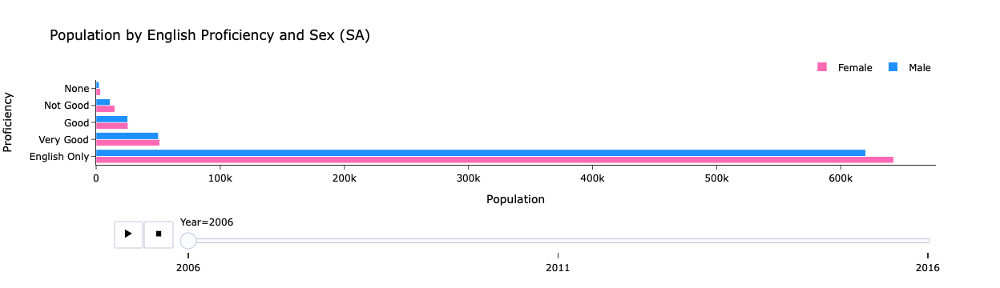

In [6]:
figsexplotly = px.histogram(df, x = "Value", y = "Proficiency", color = "Sex", animation_frame = "Year",
title = "Population by English Proficiency and Sex (SA)", labels = {"Sex": ""}, orientation = "h", barmode = "group", 
color_discrete_sequence = ["hotpink", "dodgerblue"], category_orders = {"Sex": ["Female", "Male"]})

figsexplotly.update_layout(legend = dict(orientation = "h", yanchor = "bottom", y = 1.02, xanchor = "right", x = 1),
                           font = dict(color = "black"), xaxis_title = "Population")

figsexplotly

## Age

In [7]:
age = pd.read_csv("./data/age.csv")
age

,Age,Region,Proficiency,Sex,Year,Value
0,2.5,Adelaide City,English Only,Male,2006,125
1,2.5,Adelaide City,English Only,Male,2011,145
2,2.5,Adelaide City,English Only,Male,2016,123
3,2.5,Adelaide City,English Only,Female,2006,116
4,2.5,Adelaide City,English Only,Female,2011,150
...,...,...,...,...,...,...
18895,102.5,Special Purpose Codes SA3 (SA),None,Male,2011,0
18896,102.5,Special Purpose Codes SA3 (SA),None,Male,2016,0
18897,102.5,Special Purpose Codes SA3 (SA),None,Female,2006,0
18898,102.5,Special Purpose Codes SA3 (SA),None,Female,2011,0


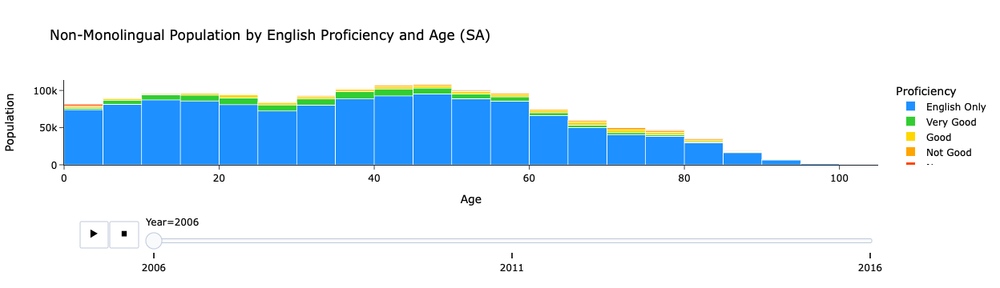

In [8]:
figageplotly = px.histogram(age, x = "Age", y = "Value", color = "Proficiency", animation_frame = "Year",
title = "Non-Monolingual Population by English Proficiency and Age (SA)", labels = {"Value": "population"},
color_discrete_sequence = ["dodgerblue", "limegreen", "gold", "orange", "orangered"])

figageplotly.update_layout(font = dict(color = "black"), yaxis_title = "Population")

figageplotly

## Income

In [37]:
combo = pd.read_csv("./data/combo.csv", index_col = "Age")[["Region", "Sex", "Good (Non-Mono)", "Income"]]
combo = combo[(combo["Good (Non-Mono)"] < 1) & (combo["Good (Non-Mono)"] > 0)].reset_index()
combo.columns = [["Age", "Region", "Sex", "Proficiency", "Income"]]
# combo.sort_values(by = "Region")

# combo["Good (Non-Mono)"] = combo["Good (Non-Mono)"] * 100
# combo.sort_values(by = "Good (Non-Mono)")
combo

,Age,Region,Sex,Proficiency,Income
0,15 - 19,Adelaide City,Female,0.835544,130.479003
1,15 - 19,Adelaide City,Male,0.800000,172.337278
2,15 - 19,Adelaide Hills,Male,0.965116,124.522293
3,15 - 19,Burnside,Female,0.920000,80.131495
4,15 - 19,Burnside,Male,0.933504,80.683428
...,...,...,...,...,...
772,95 - 99,Salisbury,Female,0.533333,412.068966
773,95 - 99,Salisbury,Male,0.666667,568.181818
774,95 - 99,Tea Tree Gully,Female,0.214286,423.046875
775,95 - 99,West Torrens,Female,0.466667,502.960526


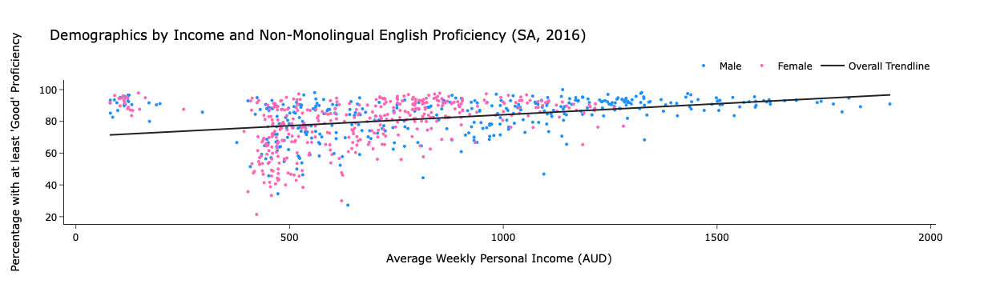

In [27]:
figincomeplotly = px.scatter(combo, x = "Income", y = "Good (Non-Mono)", color = "Sex", hover_name = "Age",
title = "Demographics by Income and Non-Monolingual English Proficiency (SA, 2016)", trendline = "ols",
trendline_scope = "overall", trendline_color_override = "#222222", color_discrete_sequence = ["dodgerblue", "hotpink"], 
category_orders = {"Sex": ["Male", "Female"]}, labels = {"Income": "Average Weekly Personal Income (AUD)", "Sex": "", 
"Good (Non-Mono)": "Percentage with at least 'Good' Proficiency"})

figincomeplotly.update_layout(font = dict(color = "black"),
                            legend = dict(orientation = "h", yanchor = "bottom", y = 1.02, xanchor = "right", x = 1))

figincomeplotly.update_traces(marker = dict(size = 4))

figincomeplotly

In [30]:
np.corrcoef(combo.dropna()["Good (Non-Mono)"].to_numpy(), combo.dropna()["Income"].to_numpy())[0,1] # pearson

0.3474097351954631

## Region

In [4]:
reg = pd.read_csv("./data/reg.csv", index_col = "Region")
reg2006 = pd.read_csv("./data/reg2006.csv", index_col = "Region")
reg2011 = pd.read_csv("./data/reg2011.csv", index_col = "Region")
reg2016 = pd.read_csv("./data/reg2016.csv", index_col = "Region")
reg

,Year,Proficiency,geometry
Region,,,
Adelaide City,2006,0.881791,POLYGON ((138.5801394681662 -34.90598407772129...
Adelaide City,2011,0.869194,POLYGON ((138.5801394681662 -34.90598407772129...
Adelaide City,2016,0.861261,POLYGON ((138.5801394681662 -34.90598407772129...
Adelaide Hills,2006,0.927481,POLYGON ((138.9617991856058 -34.77262484307849...
Adelaide Hills,2011,0.915401,POLYGON ((138.9617991856058 -34.77262484307849...
...,...,...,...
West Torrens,2011,0.838388,POLYGON ((138.5080268280403 -34.93337990490136...
West Torrens,2016,0.841341,POLYGON ((138.5080268280403 -34.93337990490136...
Yorke Peninsula,2006,0.956250,MULTIPOLYGON (((137.3630604373876 -34.45705737...


In [32]:
sa3 = gpd.read_file("./data/geo/sa3.shp")
regjson = gpd.GeoDataFrame(sa3.set_index("Region")).to_crs(epsg = 4326).__geo_interface__

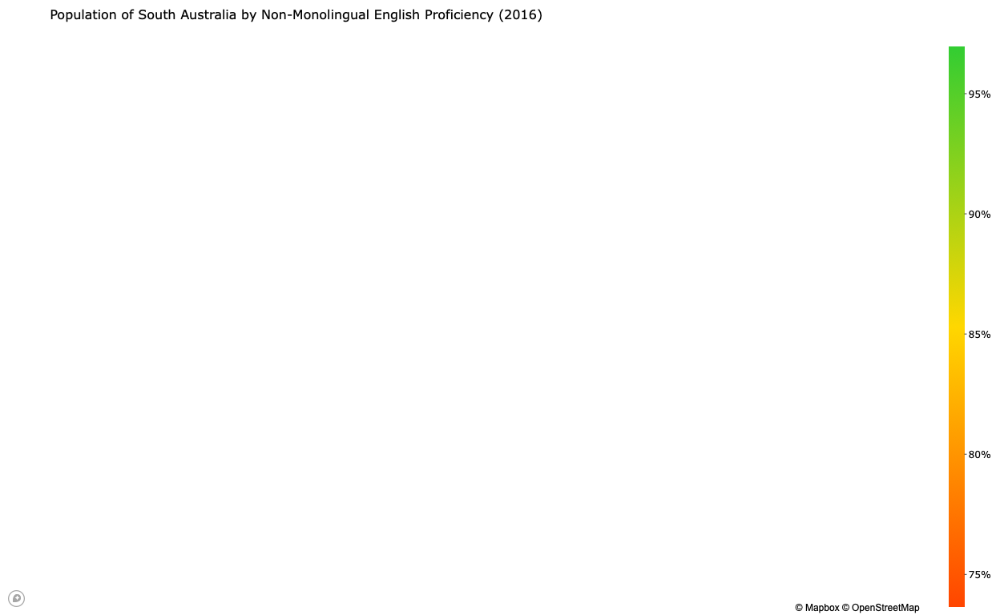

In [34]:
MAPBOX_ACCESSTOKEN = "pk.eyJ1Ijoic2ViYXN0aWFuamstdCIsImEiOiJja3Q5ZXRwMTMxYmZuMnhwNG5xZjlqOXpwIn0.1VItWkND9RmQga-S8qtQog"
df = reg2016
var = "Good (Non-Mono)"

zmin = reg2016[var].min()
zmax = reg2016[var].max()

data = go.Choroplethmapbox(geojson = regjson, locations = df.index, z = df[var], text = df.index,
colorbar = dict(thickness = 20, ticklen = 3, tickformat = "0.0%", outlinewidth = 0), marker_line_width = 1,
marker_opacity = 0.7, colorscale = ["orangered", "gold", "limegreen"], zmin = zmin, zmax = zmax)

layout = go.Layout(title = {"text": f"Population of South Australia by Non-Monolingual English Proficiency (2016)",
"font": {"size": 16}}, mapbox1 = dict(domain = {'x': [0, 1],'y': [0, 1]}, center = dict(lat = -32.25 , lon = 135),
accesstoken = MAPBOX_ACCESSTOKEN, zoom = 5), autosize = True, height = 768, width = 768,
margin = dict(l = 0, r = 0, t = 48, b = 0), font = dict(color = "black"))

fig = go.Figure(data = data, layout = layout)

fig